In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
!JAX_ENABLE_X64=True

'JAX_ENABLE_X64' is not recognized as an internal or external command,
operable program or batch file.


In [3]:
from pathlib import Path
import pandas as pd
import numpy as np

import jax
jax.config.update("jax_enable_x64", True)
import jax.numpy as jnp
from jax import grad, hessian
from scipy import optimize

import pymc as pm
from pymc.gp import Latent
from pymc.gp.cov import Periodic, ExpQuad, RatQuad, WhiteNoise
import numpyro
numpyro.set_host_device_count(4)

import matplotlib.pyplot as plt
from tueplots import bundles
from tueplots.constants.color import rgb
plt.rcParams.update(bundles.beamer_moml())
plt.rcParams.update({'figure.dpi': 300})
plt.rcParams['font.family'] = 'DeJavu Serif'
plt.rcParams['font.serif'] = ['Times New Roman']

from utils import gp, Gaussian, plotting
from utils.bayes.media_transforms import adstock, shape

WARNING (pytensor.configdefaults): g++ not available, if using conda: `conda install m2w64-toolchain`
WARNING (pytensor.configdefaults): g++ not detected!  PyTensor will be unable to compile C-implementations and will default to Python. Performance may be severely degraded. To remove this warning, set PyTensor flags cxx to an empty string.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


In [4]:
DATA_DIR = Path("./data")
DATA_FILE = DATA_DIR/"search_dataset.csv"

In [5]:
data = pd.read_csv(DATA_FILE, parse_dates=["Period"]).drop(columns=['OOH_IMPRESSIONS', "TV_IMPRESSIONS"])
data.head()

,Period,Campaign,Outlet,SEARCH_CLICKS,SEARCH_IMPRESSIONS,BING_INCIDENT,AUDIO_IMPRESSIONS,DISPLAY_IMPRESSIONS,ECOM_IMPRESSIONS,OLV_IMPRESSIONS,...,trend,cos_1,cos_2,cos_3,cos_4,sin_1,sin_2,sin_3,sin_4,norm_trend
0,2020-12-28,BRANDED,BING,83.0,1035.0,0,2489772.0,8270808.0,39229404.0,4547302.0,...,0,1.000000,0.50000,0.333333,0.250000,0.000000,0.000000,0.000000,0.000000,0.000000
1,2020-12-28,BRANDED,GOOGLE,1814.0,13956.0,0,2489772.0,8270808.0,39229404.0,4547302.0,...,0,1.000000,0.50000,0.333333,0.250000,0.000000,0.000000,0.000000,0.000000,0.000000
2,2020-12-28,UNBRANDED,BING,1711.0,50382.0,0,2489772.0,8270808.0,39229404.0,4547302.0,...,0,1.000000,0.50000,0.333333,0.250000,0.000000,0.000000,0.000000,0.000000,0.000000
3,2020-12-28,UNBRANDED,GOOGLE,5184.0,124249.0,0,2489772.0,8270808.0,39229404.0,4547302.0,...,0,1.000000,0.50000,0.333333,0.250000,0.000000,0.000000,0.000000,0.000000,0.000000
4,2021-01-04,BRANDED,BING,105.0,1261.0,0,4501153.0,7674454.0,11650964.0,3573554.0,...,1,0.992759,0.48557,0.311820,0.221557,0.120123,0.119253,0.117812,0.115812,0.019231


In [6]:
INDEX_COLS = ["Period", "Campaign", "Outlet"]

In [7]:
dates = data['Period'].unique()
len(dates)

156

In [8]:
MEDIA_VARS = [varname for varname in data.columns if "IMPRESSIONS" in varname and "SEARCH" not in varname]
ORGANIC = ["ORGANIC_SEARCH_CORE_POWER_PROTEIN_SHAKE"]
SEARCH_CLICKS = ["SEARCH_CLICKS"]
SEARCH_IMPRESSIONS = ["SEARCH_IMPRESSIONS"]
HOLIDAYS = [
 #'HOLIDAY_BIRTHDAY_OF_MARTIN_LUTHER_KING,_JR',
 'HOLIDAY_CHRISTMAS_DAY',
 #'HOLIDAY_COLUMBUS_DAY',
 'HOLIDAY_INDEPENDENCE_DAY',
 #'HOLIDAY_JUNETEENTH_NATIONAL_INDEPENDENCE_DAY',
 #'HOLIDAY_LABOR_DAY',
 'HOLIDAY_MEMORIAL_DAY',
 'HOLIDAY_NEW_YEARS_DAY',
 'HOLIDAY_THANKSGIVING_DAY',
 #'HOLIDAY_VETERANS_DAY',
 #'HOLIDAY_WASHINGTONS_BIRTHDAY'
 ]

In [9]:
INDEXES = {
    (0,0): ("BING", "BRANDED"),
    (0,1): ("BING", "UNBRANDED"),
    (1,0): ("GOOGLE", "BRANDED"),
    (1,1): ("GOOGLE", "UNBRANDED")
}

In [10]:
def make_cube(columns):
    container = np.zeros((len(dates), 2, 2, len(columns)))
    container[:, 0, 1, :] = data.query("Outlet=='BING'").query("Campaign=='UNBRANDED'")[columns]
    container[:, 1, 0, :] = data.query("Outlet=='GOOGLE'").query("Campaign=='BRANDED'")[columns]
    container[:, 0, 0, :] = data.query("Outlet=='BING'").query("Campaign=='BRANDED'")[columns]
    container[:, 1, 1, :] = data.query("Outlet=='GOOGLE'").query("Campaign=='UNBRANDED'")[columns]
    return container    

In [11]:
holiday_dummies_container = make_cube(HOLIDAYS)
holiday_dummies_container.shape

(156, 2, 2, 5)

In [12]:
media_container = make_cube(MEDIA_VARS)
media_container.shape

(156, 2, 2, 9)

In [13]:
bing_dummy_container = make_cube(["BING_INCIDENT"])
bing_dummy_container.shape

(156, 2, 2, 1)

In [14]:
np.isnan(media_container).sum()

0

In [15]:
organic_search_container = make_cube(ORGANIC)
organic_search_container.shape

(156, 2, 2, 1)

In [16]:
time_container = make_cube(['trend'])

In [17]:
np.isnan(organic_search_container).sum()

0

In [18]:
search_clicks_container = make_cube(SEARCH_CLICKS)
search_impressions_container = make_cube(SEARCH_IMPRESSIONS)

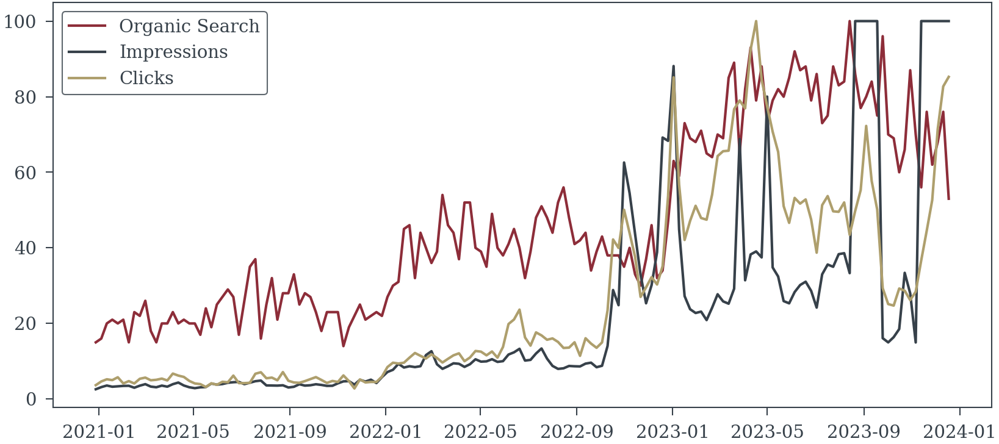

In [19]:
plt.plot(data['Period'], data[ORGANIC], label="Organic Search")
i = 0
plt.plot(data["Period"].iloc[i::4], data[SEARCH_IMPRESSIONS].iloc[i::4]/data[SEARCH_IMPRESSIONS].iloc[i::4].max()*100, label="Impressions")
plt.plot(data["Period"].iloc[i::4], data[SEARCH_CLICKS].iloc[i::4]/data[SEARCH_CLICKS].iloc[i::4].max()*100, label="Clicks")
plt.legend()

In [20]:
media_container[np.isnan(media_container)]

array([], dtype=float64)

In [21]:
from patsy import dmatrix

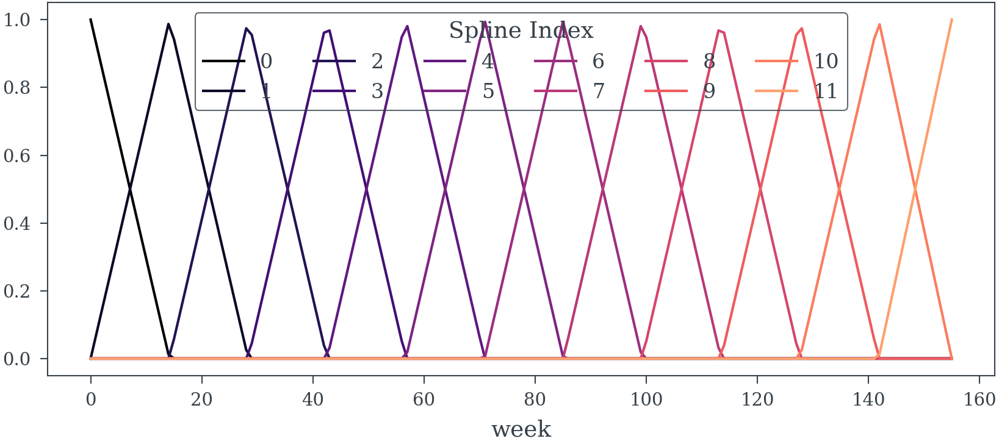

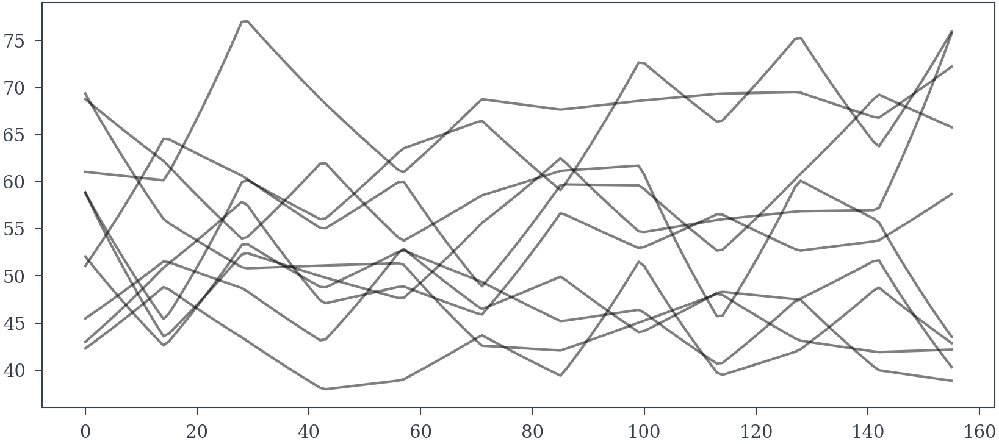

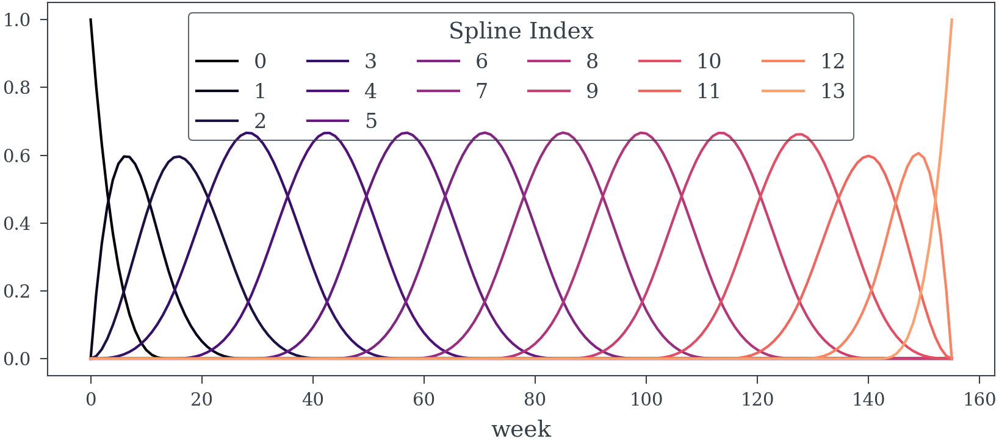

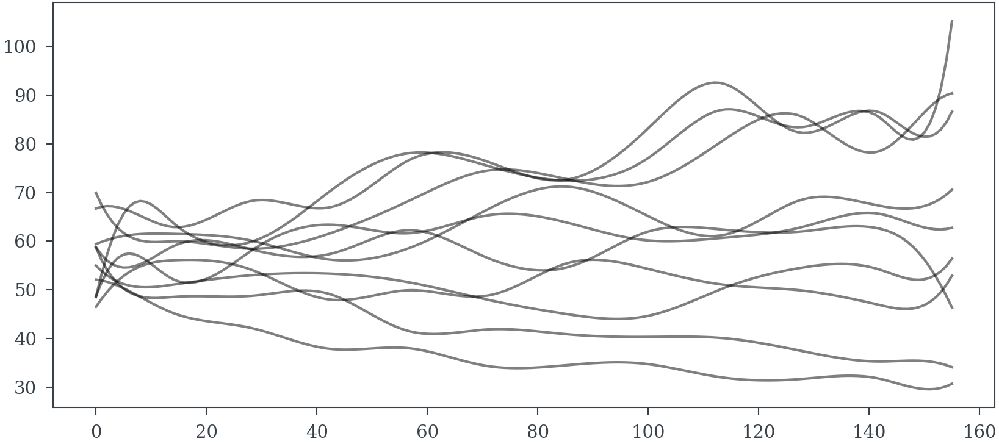

In [22]:
timescale = 13
knot_list = np.linspace(0, len(data["trend"].unique()), len(data['trend'].unique())//timescale)

B = dmatrix(
    "bs(week, knots=knots, degree=1, include_intercept=True) - 1",
    {"week": data['trend'].values, "knots": knot_list[1:-1]},
)
B_cubic = dmatrix(
    "bs(week, knots=knots, degree=3, include_intercept=True) - 1",
    {"week": data['trend'].values, "knots": knot_list[1:-1]},
)

spline_df = (
    pd.DataFrame(B)
    .assign(week=data.trend.values)
    .melt("week", var_name="spline_i", value_name="value")
)
spline_df_cubic = (
    pd.DataFrame(B_cubic)
    .assign(week=data.trend.values)
    .melt("week", var_name="spline_i", value_name="value")
)

spline_df
color = plt.cm.magma(np.linspace(0, 0.80, len(spline_df.spline_i.unique())))
fig = plt.figure()
for i, c in enumerate(color):
    subset = spline_df.query(f"spline_i == {i}")
    subset.plot("week", "value", c=c, ax=plt.gca(), label=i)
plt.legend(title="Spline Index", loc="upper center", fontsize=8, ncol=6);
fig = plt.figure()
for i in range(10):
    betas = np.random.normal(0, .1, size=B.shape[1])
    trend = np.random.normal(0, .1)
    intercept = np.random.normal(4, .1)
    plt.plot(data.trend.values, np.exp(np.asarray(B, order='F')@betas+trend*data['norm_trend'].values + intercept), c='k', alpha=.5)

color = plt.cm.magma(np.linspace(0, 0.80, len(spline_df_cubic.spline_i.unique())))
fig = plt.figure()
for i, c in enumerate(color):
    subset = spline_df_cubic.query(f"spline_i == {i}")
    subset.plot("week", "value", c=c, ax=plt.gca(), label=i)
plt.legend(title="Spline Index", loc="upper center", fontsize=8, ncol=6);
fig = plt.figure()
for i in range(10):
    betas = np.random.normal(0, .1, size=B_cubic.shape[1])
    trend = np.random.normal(0, .1)
    intercept = np.random.normal(4, .1)
    plt.plot(data.trend.values, np.exp(np.asarray(B_cubic, order='F')@betas+trend*data['norm_trend'].values + intercept), c='k', alpha=.5)

In [23]:
spline_components=[f"spline_{i}" for i in range(B.shape[1])]
data[spline_components] = np.asarray(B, order="F")
data.head()

,Period,Campaign,Outlet,SEARCH_CLICKS,SEARCH_IMPRESSIONS,BING_INCIDENT,AUDIO_IMPRESSIONS,DISPLAY_IMPRESSIONS,ECOM_IMPRESSIONS,OLV_IMPRESSIONS,...,spline_2,spline_3,spline_4,spline_5,spline_6,spline_7,spline_8,spline_9,spline_10,spline_11
0,2020-12-28,BRANDED,BING,83.0,1035.0,0,2489772.0,8270808.0,39229404.0,4547302.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2020-12-28,BRANDED,GOOGLE,1814.0,13956.0,0,2489772.0,8270808.0,39229404.0,4547302.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2020-12-28,UNBRANDED,BING,1711.0,50382.0,0,2489772.0,8270808.0,39229404.0,4547302.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2020-12-28,UNBRANDED,GOOGLE,5184.0,124249.0,0,2489772.0,8270808.0,39229404.0,4547302.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2021-01-04,BRANDED,BING,105.0,1261.0,0,4501153.0,7674454.0,11650964.0,3573554.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [24]:
spline_container = make_cube(spline_components)

In [25]:
cubic_spline_components=[f"cubic_spline_{i}" for i in range(B_cubic.shape[1])]
data[cubic_spline_components] = np.asarray(B_cubic, order="F")
data.head()

,Period,Campaign,Outlet,SEARCH_CLICKS,SEARCH_IMPRESSIONS,BING_INCIDENT,AUDIO_IMPRESSIONS,DISPLAY_IMPRESSIONS,ECOM_IMPRESSIONS,OLV_IMPRESSIONS,...,cubic_spline_4,cubic_spline_5,cubic_spline_6,cubic_spline_7,cubic_spline_8,cubic_spline_9,cubic_spline_10,cubic_spline_11,cubic_spline_12,cubic_spline_13
0,2020-12-28,BRANDED,BING,83.0,1035.0,0,2489772.0,8270808.0,39229404.0,4547302.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2020-12-28,BRANDED,GOOGLE,1814.0,13956.0,0,2489772.0,8270808.0,39229404.0,4547302.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2020-12-28,UNBRANDED,BING,1711.0,50382.0,0,2489772.0,8270808.0,39229404.0,4547302.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2020-12-28,UNBRANDED,GOOGLE,5184.0,124249.0,0,2489772.0,8270808.0,39229404.0,4547302.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2021-01-04,BRANDED,BING,105.0,1261.0,0,4501153.0,7674454.0,11650964.0,3573554.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [26]:
cubic_spline_container = make_cube(cubic_spline_components)

In [27]:
def make_fourier(n, time, period=52.18):
  sines = [np.sin(2*np.pi*(i+1)*time/period)/(2*(i+1)**1.4) for i in range(n)]
  cosines = [np.cos(2*np.pi*(i+1)*time/period)/(2*(i+1)**1.4) for i in range(n)]
  return np.vstack(sines + cosines)


(array([4.4000e+01, 1.0410e+03, 5.3290e+03, 1.3327e+04, 1.9973e+04,
        2.1014e+04, 1.6693e+04, 1.0885e+04, 6.0960e+03, 3.1330e+03,
        1.4310e+03, 6.4200e+02, 2.3400e+02, 9.8000e+01, 3.7000e+01,
        1.4000e+01, 3.0000e+00, 4.0000e+00, 1.0000e+00, 1.0000e+00]),
 array([0.68817263, 0.86361661, 1.03906059, 1.21450457, 1.38994855,
        1.56539253, 1.7408365 , 1.91628048, 2.09172446, 2.26716844,
        2.44261242, 2.6180564 , 2.79350037, 2.96894435, 3.14438833,
        3.31983231, 3.49527629, 3.67072027, 3.84616425, 4.02160822,
        4.1970522 ]),
 <BarContainer object of 20 artists>)

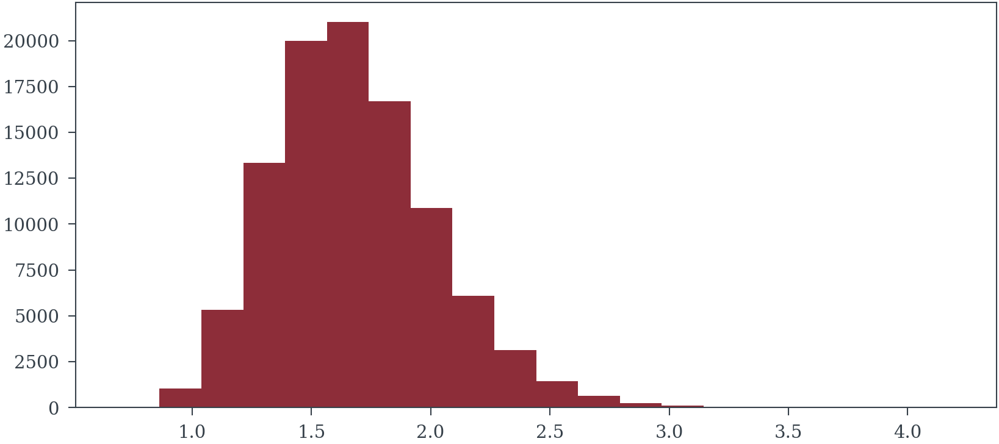

In [28]:
plt.hist(np.exp(np.random.normal(.5, .2, size=100_000)), bins=20)

In [29]:
dates = data['Period'].unique()
N_FOURIER = 4
OUTLETS = ["BING", "GOOGLE"]
CAMPAIGNS = ["BRANDED", "UNBRANDED"]
coords = {
    "media": [media_name.replace("_IMPRESSIONS", "") for media_name in MEDIA_VARS],
    "outlet": OUTLETS,
    "campaign": CAMPAIGNS,
    "date": dates,
    "splines": np.arange(B.shape[1]),
    'fourier': np.arange(2*N_FOURIER),
    'holidays': HOLIDAYS
}
fourier_data = make_fourier(4, time_container.transpose((-1, 0, 1, 2))).transpose(1, 0, 2, 3)
with pm.Model(coords=coords) as model:
  #load media data into model
  media_data_set = pm.Data("impressions", media_container, dims=("date", 'outlet', 'campaign', 'media'))
  search_impressions = pm.Data("search_impressions", search_impressions_container[:, :, :, 0], dims=("date", "outlet", "campaign"))
  
  ### Begining of Search Impressions Model
  with pm.Model(name="Impression Model", coords=coords) as impression_model:
    #Prior on average effect of media across campaigns and outlets for impressions
    betas_media_ave = pm.Normal("betas_media_mu_log", -3, 1, dims=("media"))
    #Prior on expected deviation between outlets and campaigns
    betas_media_reg = pm.HalfNormal("betas_media_sigma", .1, dims=("media"))
    #Prior on individual media effects strictly positive
    betas_media_specific = pm.Deterministic("betas_media_log", 
      pm.Normal(
      'betas_media_log_', 
      mu=0, 
      sigma=1,
      dims=('outlet', 'campaign', 'media')
      )*betas_media_reg[None, None, :] + betas_media_ave[None, None, :], dims=('outlet', 'campaign', 'media'))
  
    #Priors on shape prameters
    #K_m = pm.Uniform("K_m", .5, 7, dims=("media"))
    K_m = pm.Normal("K_m", mu=.5, sigma=.2, dims=("media"))
    #K = pm.TruncatedNormal(
    #  "K_impressions", 
    #  mu=K_m, 
    #  sigma=.01, 
    #  lower=.2, 
    #  dims=("outlet", "campaign", "media")
    #  )
    
    n_m = pm.TruncatedNormal("n_m", mu=.5, sigma=.2, lower=np.log(.9), dims="media")
    #n = pm.TruncatedNormal(
    #  "n", 
    #  mu=n_m, 
    #  sigma=.01, lower=.8, upper=3, 
    #  dims=("outlet", "campaign", "media")
    #  )
    
    #Priors on decay parameters
    decay = pm.Uniform("decay", 0.001, 0.25, dims="media")
    delay = pm.Uniform("delay", 0, 2, dims="media")


    media_effect = pm.Deterministic("media_effect", pm.math.exp(betas_media_specific) * adstock.delayed_adstock(
      shape.hill_function(media_data_set/media_data_set.mean(axis=0), pm.math.exp(n_m), pm.math.exp(K_m)), 
      decay, delay, l_max=10, normalize=True
      ), 
      dims=("date", "outlet", 'campaign', "media"))
    
    total_media_effect = pm.Deterministic("total_media_effect", media_effect.sum(axis=-1), dims=("date", "outlet", "campaign"))
  
    holiday_betas = pm.Normal("holiday_betas", 0, 1, dims=('outlet', 'campaign', 'holidays'))
    
    season_beta = pm.Normal("season_beta",0, 1, dims=('fourier'))
  
    season_scale = pm.HalfNormal("season_scale", .05, dims=('outlet', 'campaign'))
    local_weights = pm.Normal("local_weights", 0, .5, dims=('outlet', 'campaign', 'splines'))
    #local_weights_mu = pm.Normal("local_weights", 0, .5, dims='splines')
    
    global_trend = pm.Normal("global_trend", 0, 1, dims=("outlet", 'campaign'))
    intercept = pm.Normal("intercept", np.mean(np.log(search_impressions_container[:, :, :, 0]), axis=0), .4, dims=("outlet", 'campaign'))
    bing_dummy = pm.Normal("bing_dummy", 0, 1)
    season_unscaled = pm.math.sum(fourier_data*season_beta[None,:, None, None], axis=1)
    season_unscaled = 2*(season_unscaled - season_unscaled.min())/(season_unscaled.max() - season_unscaled.min()) - 1

    season = pm.Deterministic("season", season_unscaled*season_scale, dims=("date", "outlet", "campaign"))
    trend = pm.Deterministic("trend", pm.math.sum(spline_container*local_weights[None, ...], axis=-1) + global_trend*time_container[:, :,:, 0]/np.max(time_container) + intercept, dims=("date", "outlet", "campaign"))
    holiday_effects = pm.Deterministic("holidays", pm.math.sum(holiday_dummies_container*holiday_betas, axis=-1), dims=("date", "outlet", "campaign"))
    alpha = pm.Exponential("sigma", .01, dims=("outlet", "campaign"))
    mu = pm.Deterministic("impression_rate", total_media_effect + season + trend + holiday_effects, dims=("date", "outlet", "campaign"))
    mu_why_bing = mu + bing_dummy_container[:, :, :, 0]*bing_dummy
    
    impressions_sample = pm.NegativeBinomial('impressions_obs', mu=np.exp(mu_why_bing), alpha=alpha, observed=search_impressions, dims=("date", "outlet", "campaign"))
  #sales_m = pm.Normal("sales", mu, sigma, observed=np.log(sales))
  #trace = pm.sample(2000, tune=2000, nuts_sampler='numpyro')
  

In [30]:
dates = data['Period'].unique()
N_FOURIER = 4
OUTLETS = ["BING", "GOOGLE"]
CAMPAIGNS = ["BRANDED", "UNBRANDED"]
coords = {
    "media": [media_name.replace("_IMPRESSIONS", "") for media_name in MEDIA_VARS],
    "outlet": OUTLETS,
    "campaign": CAMPAIGNS,
    "date": dates,
    "splines": np.arange(B_cubic.shape[1]),
    'fourier': np.arange(2*N_FOURIER),
    'holidays': HOLIDAYS
}
fourier_data = make_fourier(4, time_container.transpose((-1, 0, 1, 2))).transpose(1, 0, 2, 3)
with pm.Model(coords=coords) as cubic_model:
  #load media data into model
  media_data_set = pm.Data("impressions", media_container, dims=("date", 'outlet', 'campaign', 'media'))
  search_impressions = pm.Data("search_impressions", search_impressions_container[:, :, :, 0], dims=("date", "outlet", "campaign"))
  
  ### Begining of Search Impressions Model
  with pm.Model(name="Impression Model", coords=coords) as impression_model:
    #Prior on average effect of media across campaigns and outlets for impressions
    betas_media_ave = pm.Normal("betas_media_mu_log", -3, 1, dims=("media"))
    #Prior on expected deviation between outlets and campaigns
    betas_media_reg = pm.HalfNormal("betas_media_sigma", .1, dims=("media"))
    #Prior on individual media effects strictly positive
    betas_media_specific = pm.Deterministic("betas_media_log", 
      pm.Normal(
      'betas_media_log_', 
      mu=0, 
      sigma=1,
      dims=('outlet', 'campaign', 'media')
      )*betas_media_reg[None, None, :] + betas_media_ave[None, None, :], dims=('outlet', 'campaign', 'media'))
  
    #Priors on shape prameters
    #K_m = pm.Uniform("K_m", .5, 7, dims=("media"))
    K_m = pm.Normal("K_m", mu=.5, sigma=.2, dims=("media"))
    #K = pm.TruncatedNormal(
    #  "K_impressions", 
    #  mu=K_m, 
    #  sigma=.01, 
    #  lower=.2, 
    #  dims=("outlet", "campaign", "media")
    #  )
    
    n_m = pm.TruncatedNormal("n_m", mu=.5, sigma=.2, lower=np.log(.9), dims="media")
    #n = pm.TruncatedNormal(
    #  "n", 
    #  mu=n_m, 
    #  sigma=.01, lower=.8, upper=3, 
    #  dims=("outlet", "campaign", "media")
    #  )
    
    #Priors on decay parameters
    decay = pm.Uniform("decay", 0.001, 0.25, dims="media")
    delay = pm.Uniform("delay", 0, 2, dims="media")


    media_effect = pm.Deterministic("media_effect", pm.math.exp(betas_media_specific) * adstock.delayed_adstock(
      shape.hill_function(media_data_set/media_data_set.mean(axis=0), pm.math.exp(n_m), pm.math.exp(K_m)), 
      decay, delay, l_max=10, normalize=True
      ), 
      dims=("date", "outlet", 'campaign', "media"))
    
    total_media_effect = pm.Deterministic("total_media_effect", media_effect.sum(axis=-1), dims=("date", "outlet", "campaign"))
  
    holiday_betas = pm.Normal("holiday_betas", 0, 1, dims=('outlet', 'campaign', 'holidays'))
    
    season_beta = pm.Normal("season_beta",0, 1, dims=('fourier'))
  
    season_scale = pm.HalfNormal("season_scale", .05, dims=('outlet', 'campaign'))
    local_weights = pm.Normal("local_weights", 0, .5, dims=('outlet', 'campaign', 'splines'))
    #local_weights_mu = pm.Normal("local_weights", 0, .5, dims='splines')
    
    global_trend = pm.Normal("global_trend", 0, 1, dims=("outlet", 'campaign'))
    intercept = pm.Normal("intercept", np.mean(np.log(search_impressions_container[:, :, :, 0]), axis=0), .4, dims=("outlet", 'campaign'))
    bing_dummy = pm.Normal("bing_dummy", 0, 1)
    season_unscaled = pm.math.sum(fourier_data*season_beta[None,:, None, None], axis=1)
    season_unscaled = 2*(season_unscaled - season_unscaled.min())/(season_unscaled.max() - season_unscaled.min()) - 1

    season = pm.Deterministic("season", season_unscaled*season_scale, dims=("date", "outlet", "campaign"))
    trend = pm.Deterministic("trend", pm.math.sum(cubic_spline_container*local_weights[None, ...], axis=-1) + global_trend*time_container[:, :,:, 0]/np.max(time_container) + intercept, dims=("date", "outlet", "campaign"))
    holiday_effects = pm.Deterministic("holidays", pm.math.sum(holiday_dummies_container*holiday_betas, axis=-1), dims=("date", "outlet", "campaign"))
    alpha = pm.Exponential("sigma", .01)
    mu = pm.Deterministic("impression_rate", total_media_effect + season + trend + holiday_effects, dims=("date", "outlet", "campaign"))
    mu_why_bing = mu + bing_dummy_container[:, :, :, 0]*bing_dummy
    
    impressions_sample = pm.NegativeBinomial('impressions_obs', mu=np.exp(mu_why_bing), alpha=alpha, observed=search_impressions, dims=("date", "outlet", "campaign"))
  #sales_m = pm.Normal("sales", mu, sigma, observed=np.log(sales))
  #trace = pm.sample(2000, tune=2000, nuts_sampler='numpyro')

In [31]:
import datetime

In [32]:
datetime.datetime.now().strftime("%d_%m_%Y_%H:%M:%S")

'13_06_2024_09:25:30'

In [33]:
with cubic_model:
    cubic_trace_new = pm.sample(1000, tune=1000, nuts_sampler='numpyro', target_accept=.99)

d:\python\envs\search_model\Lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(


  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

In [34]:
cubic_trace_new.to_netcdf("trace_with_holiday_cubespline_lognormal_everywhere_extra_alpha.nc")

'trace_with_holiday_cubespline_lognormal_everywhere_extra_alpha.nc'

In [35]:
trace_new = cubic_trace_new

In [146]:
with model:
    trace_new = pm.sample(1000, tune=1000, nuts_sampler='numpyro', target_accept=.99)


d:\python\envs\search_model\Lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(


  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

In [147]:
trace_new.to_netcdf("trace_with_holiday_linspline_lognormal_everywhere.nc")

'trace_with_holiday_linspline_lognormal_everywhere.nc'

In [148]:
#prior_samples_media_effect = pm.draw(media_effect, 1000)

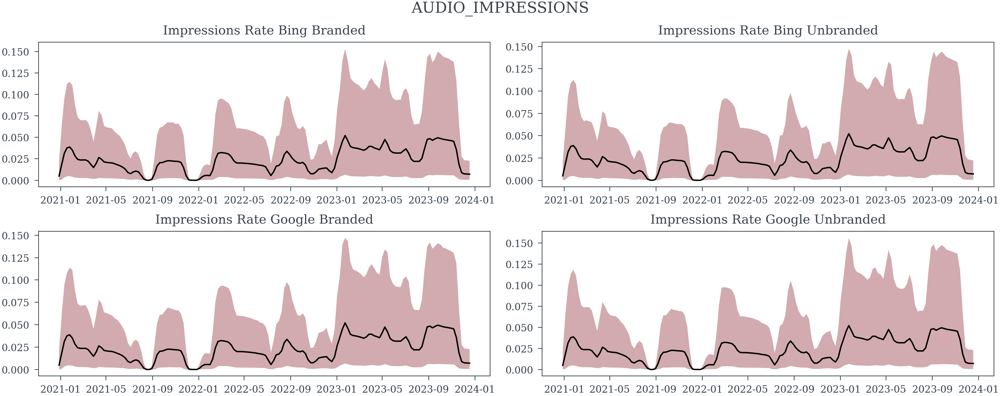

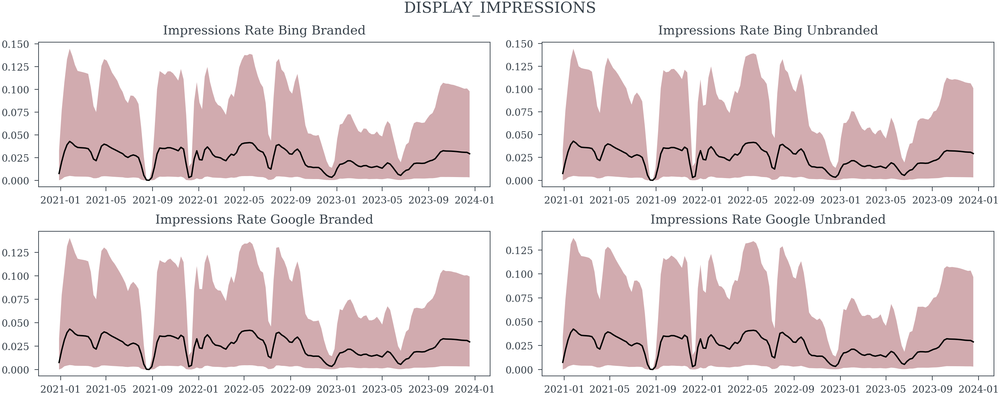

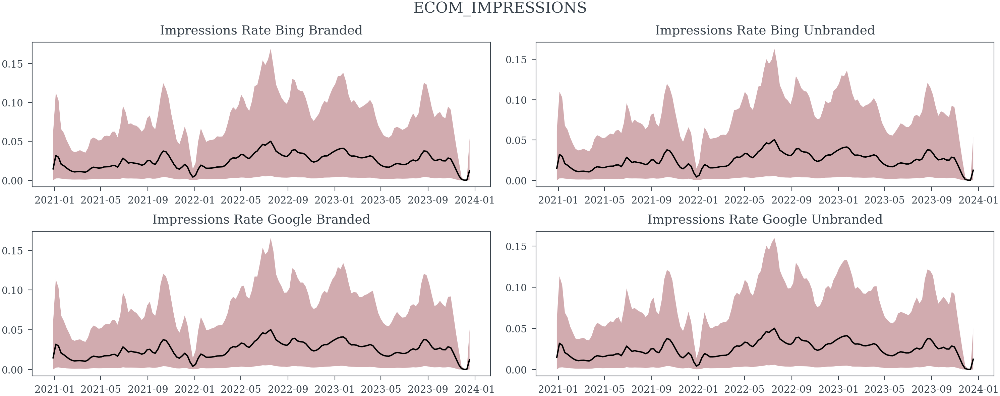

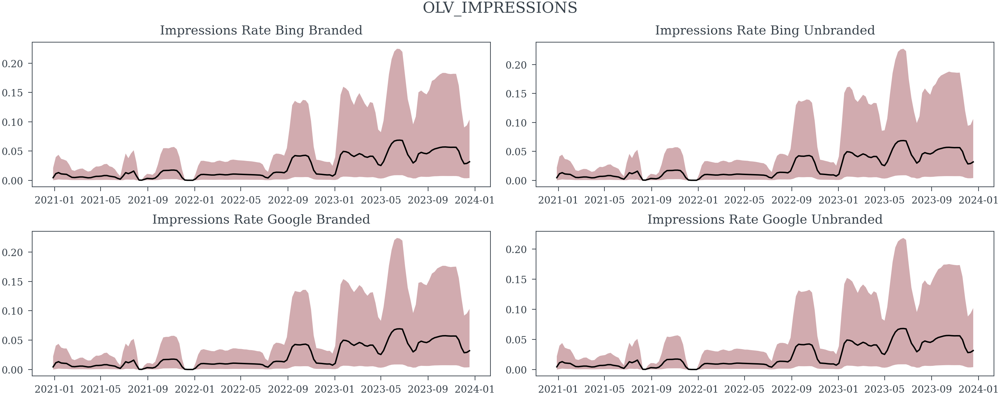

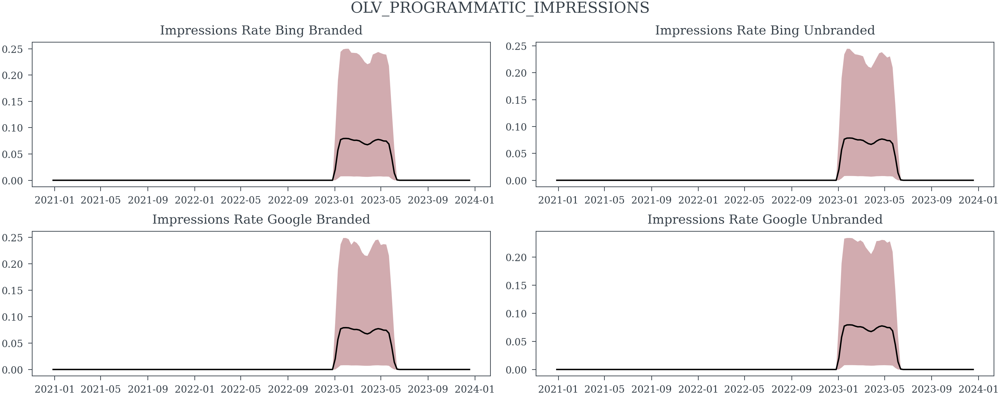

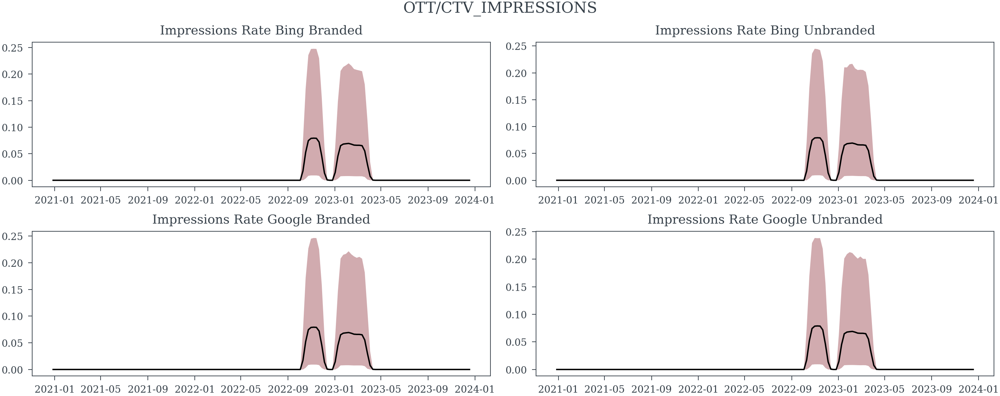

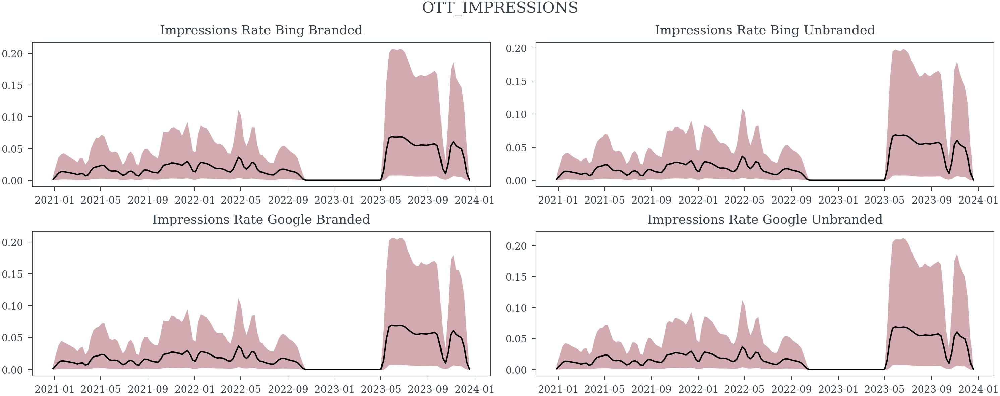

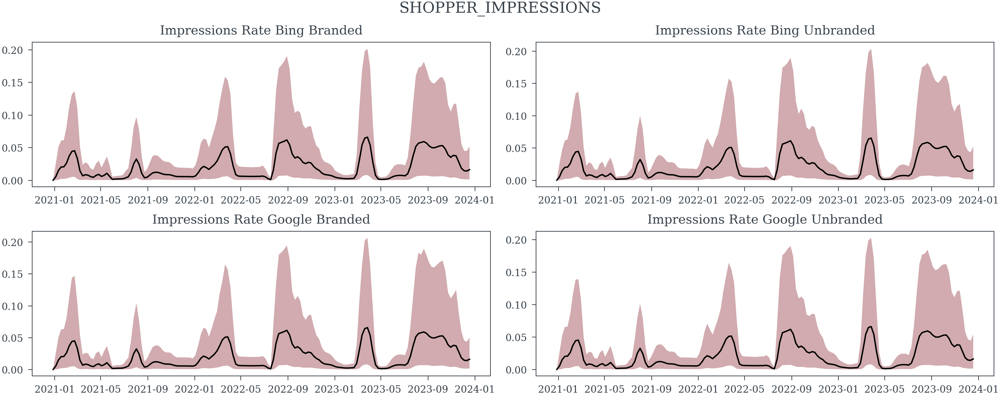

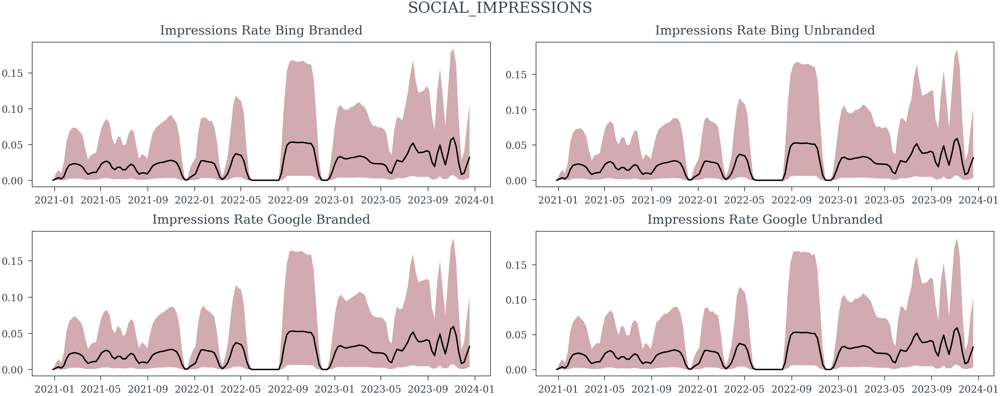

In [145]:
for channel in range(len(MEDIA_VARS)):
    fig, ax = plt.subplots(2, 2, figsize=(10,4))
    for i in range(2):
        for j in range(2):
            #ax[i, j].plot(dates, search_impressions_container[:, i, j, 0])
            ax[i, j].fill_between(dates, 
                              np.quantile(prior_samples_media_effect[:, :, i, j, channel], .05, axis=0),
                              np.quantile(prior_samples_media_effect[:, :, i, j, channel], .95, axis=0),
                              alpha=.4)
            ax[i, j].plot(dates, np.mean(prior_samples_media_effect[:, :, i, j, channel], axis=0), c='k')
            ax[i, j].set_title(f"Impressions Rate {OUTLETS[i].capitalize()} {CAMPAIGNS[j].capitalize()}")
    plt.suptitle(MEDIA_VARS[channel])

In [36]:
model_summary = pm.summary(trace_new)
model_summary.to_csv("ModelSummaryNEW.csv")

d:\python\envs\search_model\Lib\site-packages\arviz\stats\diagnostics.py:592: RuntimeWarning: invalid value encountered in scalar divide
  (between_chain_variance / within_chain_variance + num_samples - 1) / (num_samples)
d:\python\envs\search_model\Lib\site-packages\arviz\stats\diagnostics.py:592: RuntimeWarning: invalid value encountered in scalar divide
  (between_chain_variance / within_chain_variance + num_samples - 1) / (num_samples)
d:\python\envs\search_model\Lib\site-packages\arviz\stats\diagnostics.py:592: RuntimeWarning: invalid value encountered in scalar divide
  (between_chain_variance / within_chain_variance + num_samples - 1) / (num_samples)
d:\python\envs\search_model\Lib\site-packages\arviz\stats\diagnostics.py:592: RuntimeWarning: invalid value encountered in scalar divide
  (between_chain_variance / within_chain_variance + num_samples - 1) / (num_samples)
d:\python\envs\search_model\Lib\site-packages\arviz\stats\diagnostics.py:592: RuntimeWarning: invalid value enco

In [150]:
pm.summary(trace_new, var_names=["Impression Model::betas_media_log"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
"Impression Model::betas_media_log[BING, BRANDED, AUDIO]",-3.552,0.796,-5.014,-2.085,0.010,0.008,5983.0,3234.0,1.0
"Impression Model::betas_media_log[BING, BRANDED, DISPLAY]",-3.127,0.887,-4.720,-1.423,0.012,0.009,5339.0,3215.0,1.0
"Impression Model::betas_media_log[BING, BRANDED, ECOM]",-3.285,0.890,-4.911,-1.625,0.012,0.009,5437.0,2874.0,1.0
"Impression Model::betas_media_log[BING, BRANDED, OLV]",-3.578,0.783,-5.010,-2.130,0.011,0.008,5147.0,3207.0,1.0
"Impression Model::betas_media_log[BING, BRANDED, OLV_PROGRAMMATIC]",-3.455,0.834,-5.034,-1.944,0.013,0.009,4358.0,2983.0,1.0
"Impression Model::betas_media_log[BING, BRANDED, OTT/CTV]",-2.249,0.700,-3.656,-1.225,0.014,0.010,2948.0,2230.0,1.0
"Impression Model::betas_media_log[BING, BRANDED, OTT]",-3.614,0.773,-5.005,-2.202,0.010,0.008,5742.0,3055.0,1.0
"Impression Model::betas_media_log[BING, BRANDED, SHOPPER]",-2.843,0.796,-4.397,-1.552,0.015,0.011,3200.0,2650.0,1.0
"Impression Model::betas_media_log[BING, BRANDED, SOCIAL]",-3.246,0.830,-4.725,-1.695,0.013,0.010,4133.0,2835.0,1.0
"Impression Model::betas_media_log[BING, UNBRANDED, AUDIO]",-3.550,0.795,-5.004,-2.100,0.010,0.008,5974.0,3214.0,1.0


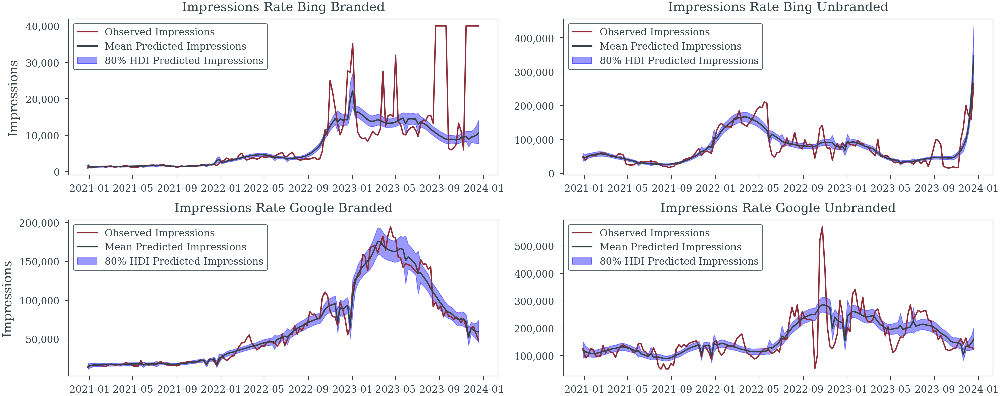

In [37]:
fig, ax = plt.subplots(2, 2, figsize=(10,4))
for i in range(2):
    for j in range(2):
        ax[i, j].plot(dates, search_impressions_container[:, i, j, 0], label='Observed Impressions')
        ax[i, j].plot(dates, np.mean(np.exp(trace_new.posterior['Impression Model::impression_rate'].values[:, :, :, i, j]), axis=(0, 1)), label='Mean Predicted Impressions')
        ax[i, j].fill_between(dates, 
                               np.quantile(np.exp(trace_new.posterior['Impression Model::impression_rate'].values[:, :,:, i, j]),.1, axis=(0, 1)),
                               np.quantile(np.exp(trace_new.posterior['Impression Model::impression_rate'].values[:, :, :, i, j]), .9, axis=(0, 1)), label="80% HDI Predicted Impressions", alpha=.4, color='blue')
        ax[i, j].set_title(f"Impressions Rate {OUTLETS[i].capitalize()} {CAMPAIGNS[j].capitalize()}")
        ax[i, j].legend()
        if j == 0:
            ax[i, j].set_ylabel("Impressions")
        ax[i, j].yaxis.set_major_formatter('{x:,.0f}')
fig.savefig("plots/model_fit")

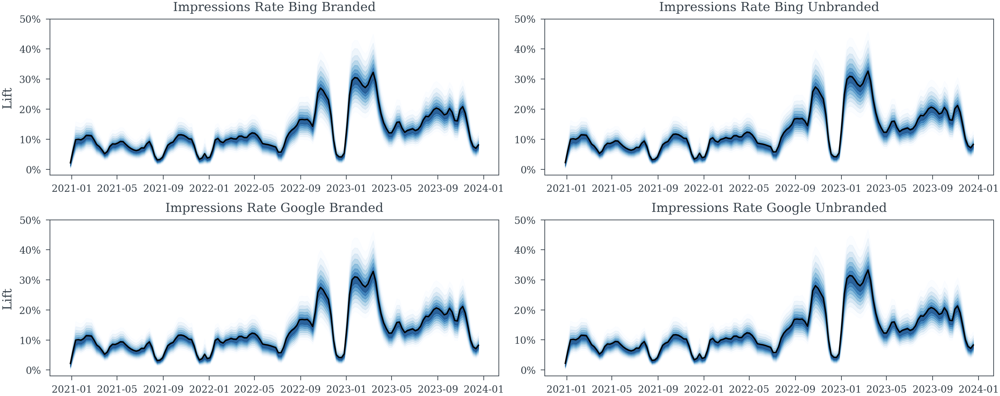

In [38]:
fig, ax = plt.subplots(2, 2, figsize=(10,4))
yticks = np.linspace(0, .5, 6)
ytick_names = [f"{ytick:.0%}" for ytick in yticks]
for i in range(2):
    for j in range(2):
        #ax[i, j].plot(dates, search_impressions_container[:, i, j, 0])
        for k in range(8):
            ax[i, j].fill_between(dates, 
                              np.quantile(np.exp(trace_new.posterior['Impression Model::total_media_effect'].values[:, :, :, i, j])-1, .5-(7-k+1)*.05, axis=(0, 1)),
                              np.quantile(np.exp(trace_new.posterior['Impression Model::total_media_effect'].values[:, :, :, i, j])-1, .5+(7-k+1)*.05, axis=(0, 1)),
                              alpha=.4, color=plt.cm.Blues(k/7))
        ax[i, j].plot(dates, np.mean(np.exp(trace_new.posterior["Impression Model::total_media_effect"].values[:, :, :, i, j])-1, axis=(0, 1)), c='k')
        ax[i, j].set_title(f"Impressions Rate {OUTLETS[i].capitalize()} {CAMPAIGNS[j].capitalize()}")
        if j == 0:
            ax[i, j].set_ylabel("Lift")

        ax[i, j].set_yticks(yticks, ytick_names)
fig.savefig('plots/total_media_effect')

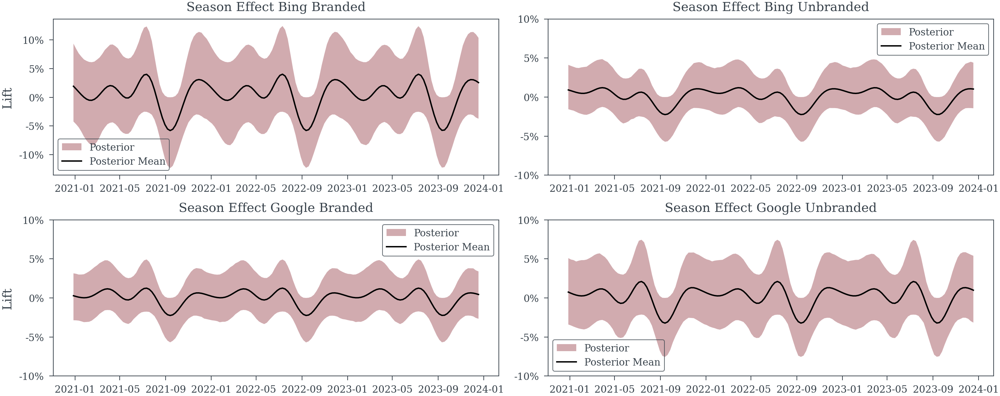

In [39]:
fig, ax = plt.subplots(2, 2, figsize=(10,4))
yticks = np.linspace(-.1, .1, 5)
ytick_names = [f'{ytick:.0%}' for ytick in yticks]
for i in range(2):
    for j in range(2):
            #ax[i, j].plot(dates, search_impressions_container[:, i, j, 0])
        ax[i, j].fill_between(dates, 
                              np.quantile(np.exp(trace_new.posterior['Impression Model::season'].values[:, :, :, i, j])-1, .10, axis=(0, 1)),
                              np.quantile(np.exp(trace_new.posterior['Impression Model::season'].values[:, :, :, i, j])-1, .90, axis=(0, 1)),
                              alpha=.4, label="Posterior")
            
        ax[i, j].plot(dates, np.mean(np.exp(trace_new.posterior["Impression Model::season"].values[:, :, :, i, j])-1, axis=(0, 1)), c='k', label='Posterior Mean')
        ax[i, j].set_title(f"Season Effect {OUTLETS[i].capitalize()} {CAMPAIGNS[j].capitalize()}")
        ax[i, j].legend()
        if j == 0:
            ax[i, j].set_ylabel("Lift")
        ax[i, j].set_yticks(yticks, ytick_names)
fig.savefig("plots/season")

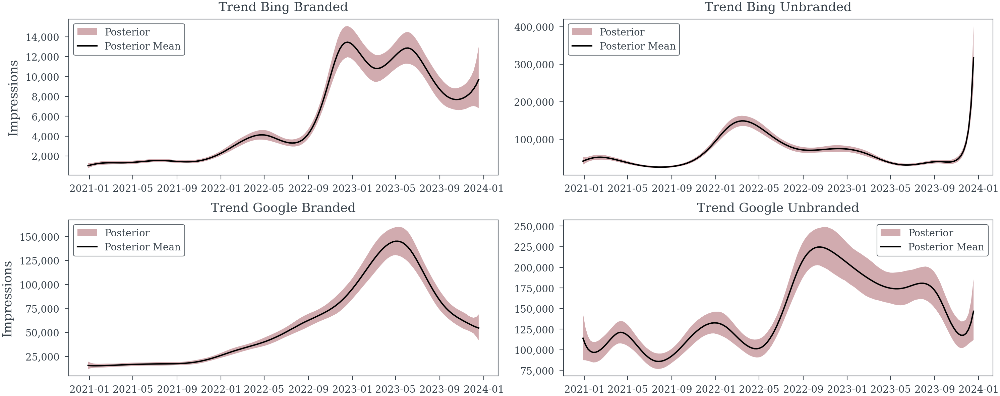

In [40]:
fig, ax = plt.subplots(2, 2, figsize=(10,4))

for i in range(2):
    for j in range(2):
            #ax[i, j].plot(dates, search_impressions_container[:, i, j, 0])
        ax[i, j].fill_between(dates, 
                              np.quantile(np.exp(trace_new.posterior['Impression Model::trend'].values[:, :, :, i, j]), .10, axis=(0, 1)),
                              np.quantile(np.exp(trace_new.posterior['Impression Model::trend'].values[:, :, :, i, j]), .90, axis=(0, 1)),
                              alpha=.4, label="Posterior")
            
        ax[i, j].plot(dates, np.mean(np.exp(trace_new.posterior["Impression Model::trend"].values[:, :, :, i, j]), axis=(0, 1)), c='k', label='Posterior Mean')
        ax[i, j].set_title(f"Trend {OUTLETS[i].capitalize()} {CAMPAIGNS[j].capitalize()}")
        ax[i, j].legend()
        if j == 0:
            ax[i, j].set_ylabel("Impressions")
        ax[i, j].yaxis.set_major_formatter('{x:,.0f}')
        #ax[i, j].set_yticks(yticks, ytick_names)
fig.savefig("plots/trend")

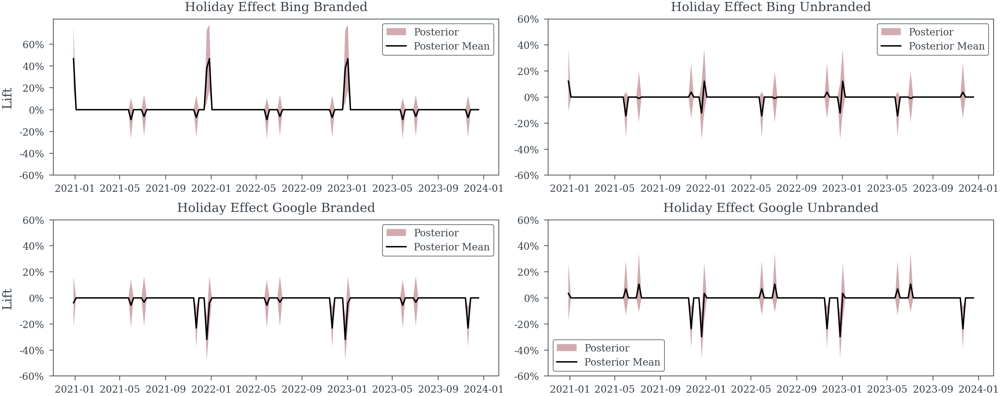

In [41]:
fig, ax = plt.subplots(2, 2, figsize=(10,4))
yticks = np.linspace(-.6, .6, 7)
ytick_names = [f'{ytick:.0%}' for ytick in yticks]
for i in range(2):
    for j in range(2):
            #ax[i, j].plot(dates, search_impressions_container[:, i, j, 0])
        ax[i, j].fill_between(dates, 
                              np.quantile(np.exp(trace_new.posterior['Impression Model::holidays'].values[:, :, :, i, j])-1, .10, axis=(0, 1)),
                              np.quantile(np.exp(trace_new.posterior['Impression Model::holidays'].values[:, :, :, i, j])-1, .90, axis=(0, 1)),
                              alpha=.4, label="Posterior")
            
        ax[i, j].plot(dates, np.mean(np.exp(trace_new.posterior["Impression Model::holidays"].values[:, :, :, i, j])-1, axis=(0, 1)), c='k', label='Posterior Mean')
        ax[i, j].set_title(f"Holiday Effect {OUTLETS[i].capitalize()} {CAMPAIGNS[j].capitalize()}")
        ax[i, j].legend()
        if j == 0:
            ax[i, j].set_ylabel("Lift")
        ax[i, j].set_yticks(yticks, ytick_names)
        
fig.savefig("plots/holiday_effects")

In [42]:
hdis = [pm.hdi(np.exp(trace_new.posterior["Impression Model::media_effect"])-1, hdi_prob=i) for i in [.9, .8, .7, .6, .5, .4, .3, .2, .1]]


In [43]:
hdis[0].to_array().values.shape

(1, 156, 2, 2, 9, 2)

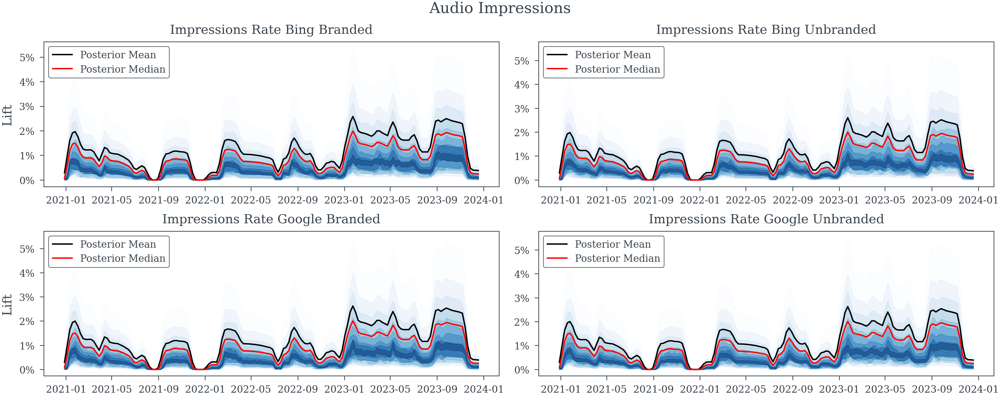

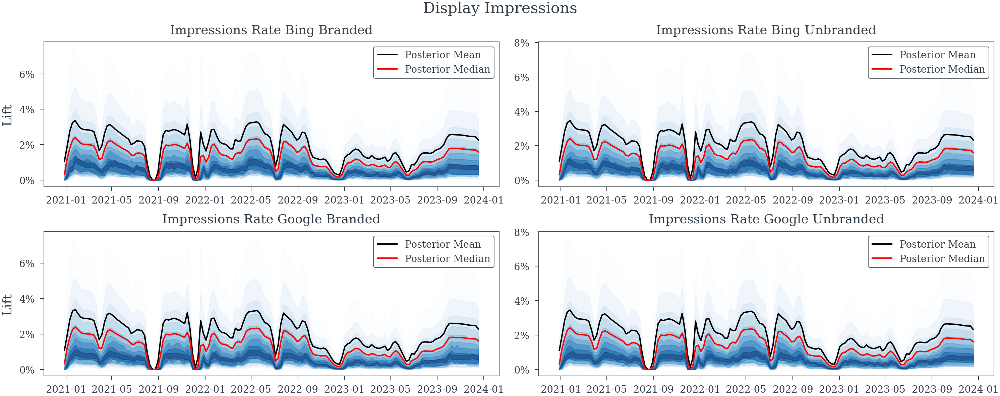

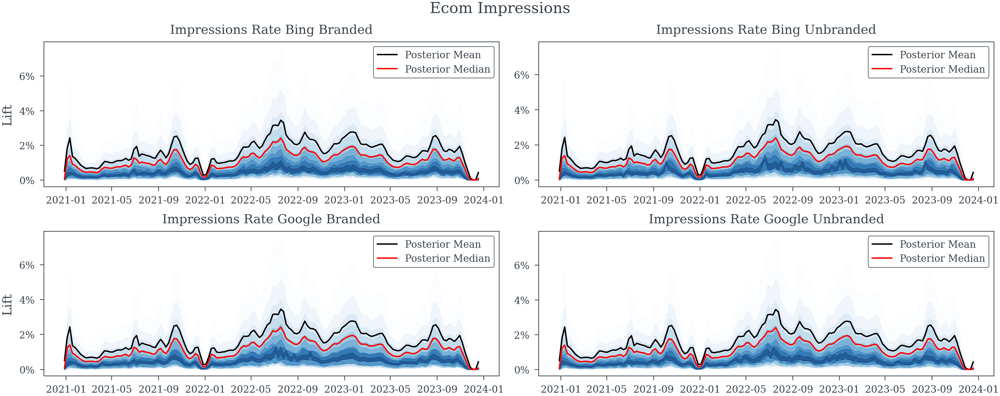

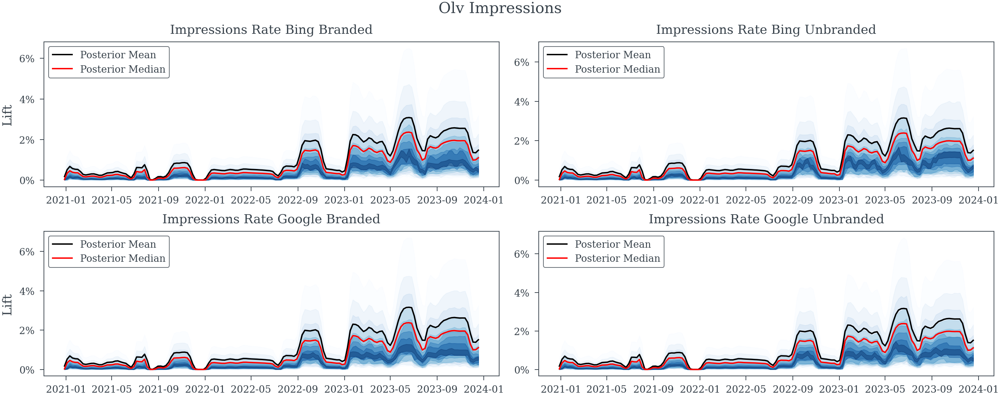

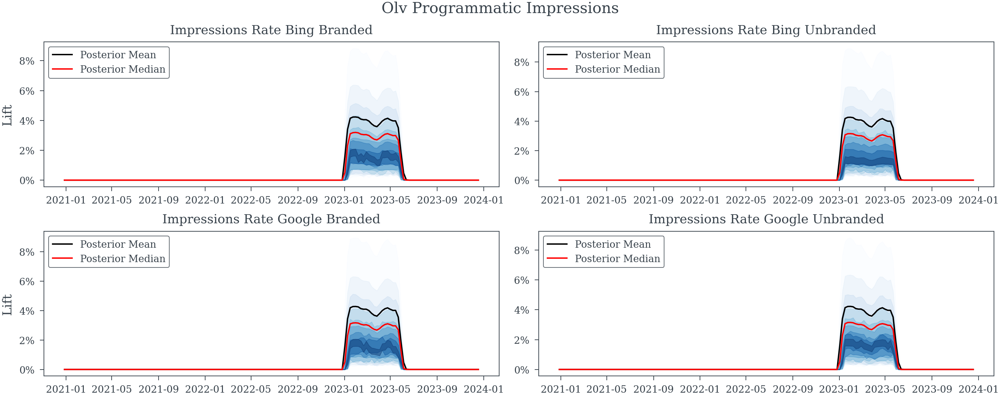

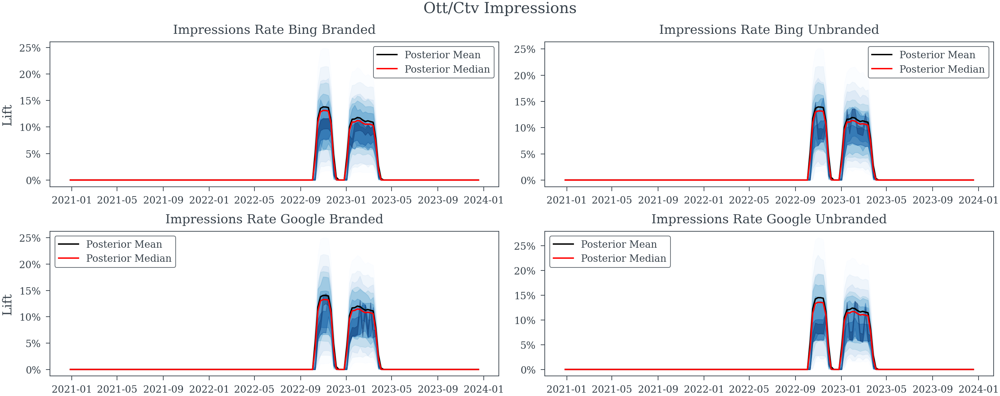

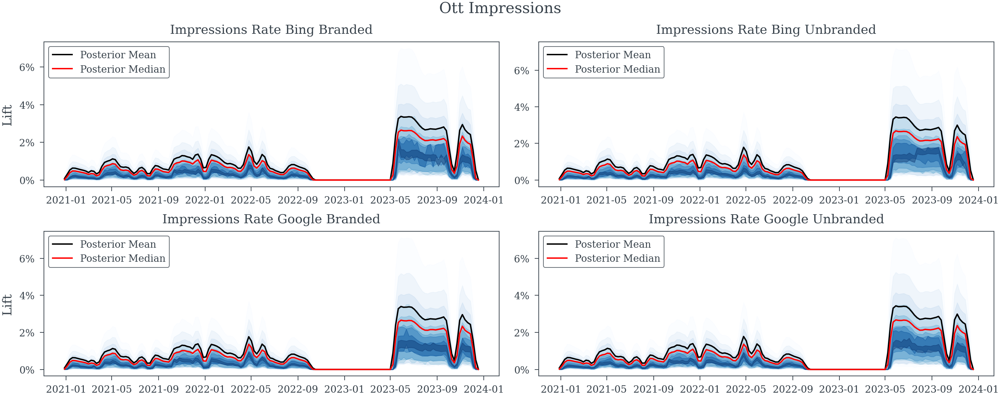

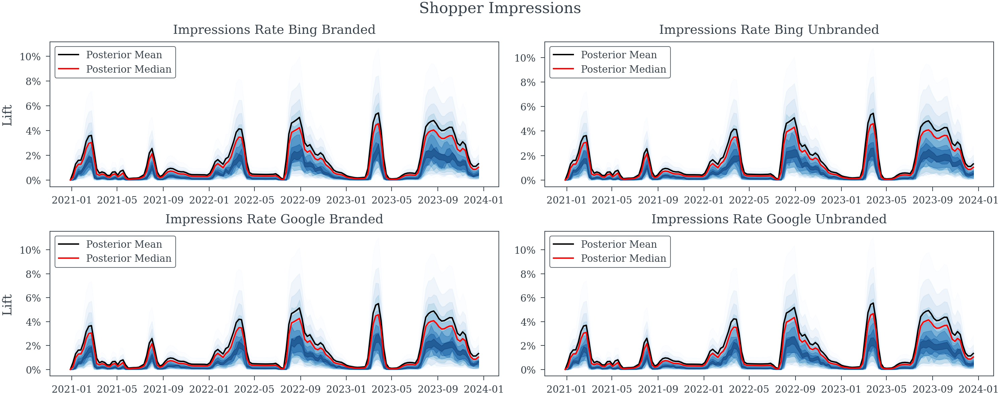

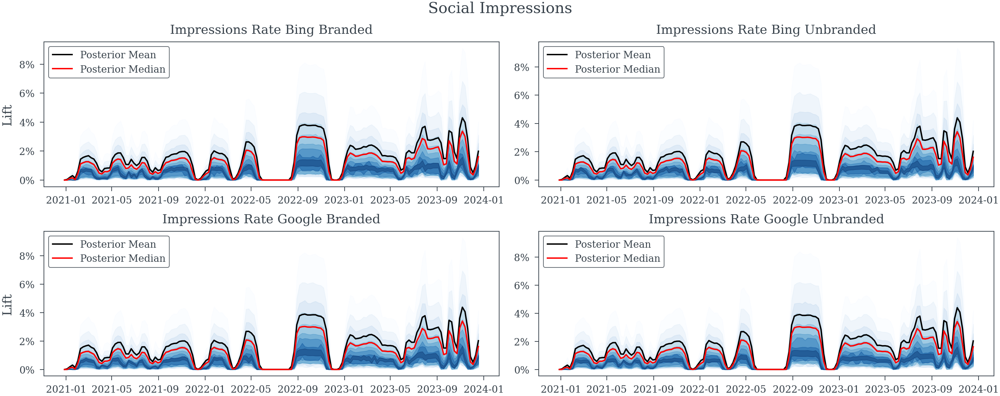

In [44]:
for channel in range(len(MEDIA_VARS)):
    fig, ax = plt.subplots(2, 2, figsize=(10,4))
    for i in range(2):
        for j in range(2):
            #ax[i, j].plot(dates, search_impressions_container[:, i, j, 0])
            for k in range(9):
                
                ax[i, j].fill_between(dates, 
                              hdis[k].to_array().values[0, :, i, j, channel, 0],
                              hdis[k].to_array().values[0,:, i, j, channel, 1],
                             alpha=.4, color=plt.cm.Blues(k/8))
            #ax[i, j].fill_between(dates, 
            #                  np.quantile(prior_samples_media_effect[:, :, i, j, channel], .05, axis=0),
            #                  np.quantile(prior_samples_media_effect[:, :, i, j, channel], .95, axis=0),
            #                  alpha=.2, color='b', label='Prior')
            ax[i, j].plot(dates, np.mean(np.exp(trace_new.posterior["Impression Model::media_effect"].values[:, :, :, i, j, channel])-1, axis=(0, 1)), c='k', label='Posterior Mean')
            ax[i, j].plot(dates, np.quantile(np.exp(trace_new.posterior["Impression Model::media_effect"].values[:, :, :, i, j, channel])-1,.5, axis=(0, 1)), c='r', label='Posterior Median')
            ax[i, j].set_title(f"Impressions Rate {OUTLETS[i].capitalize()} {CAMPAIGNS[j].capitalize()}")
            ax[i, j].legend()
            if j == 0:
                ax[i, j].set_ylabel("Lift")
            ax[i, j].yaxis.set_major_formatter('{x:.0%}')
    plt.suptitle(MEDIA_VARS[channel].replace("_", " ").title())
    fig.savefig(f"plots/{MEDIA_VARS[channel].replace('/', '_')} effect")

In [131]:
season_samples = pm.draw(season_scale, 2)
season_samples.shape

(2, 2, 2)

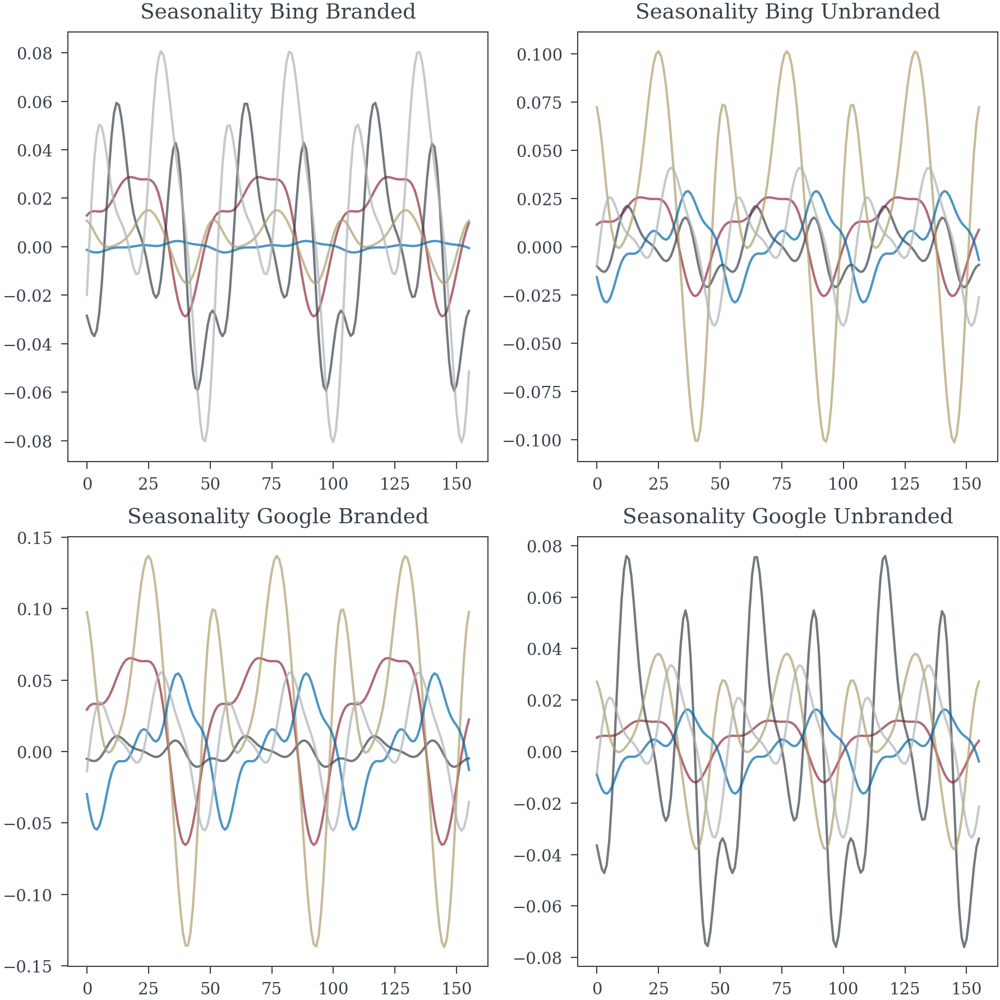

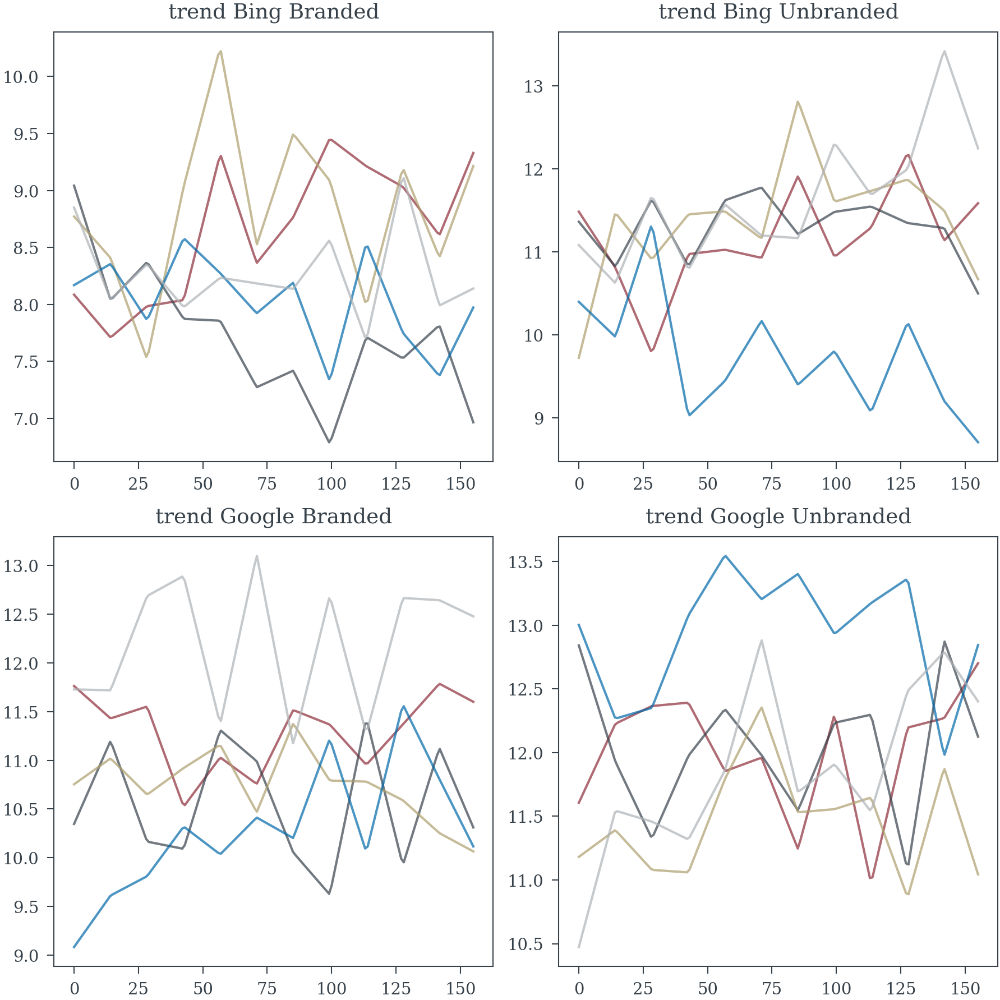

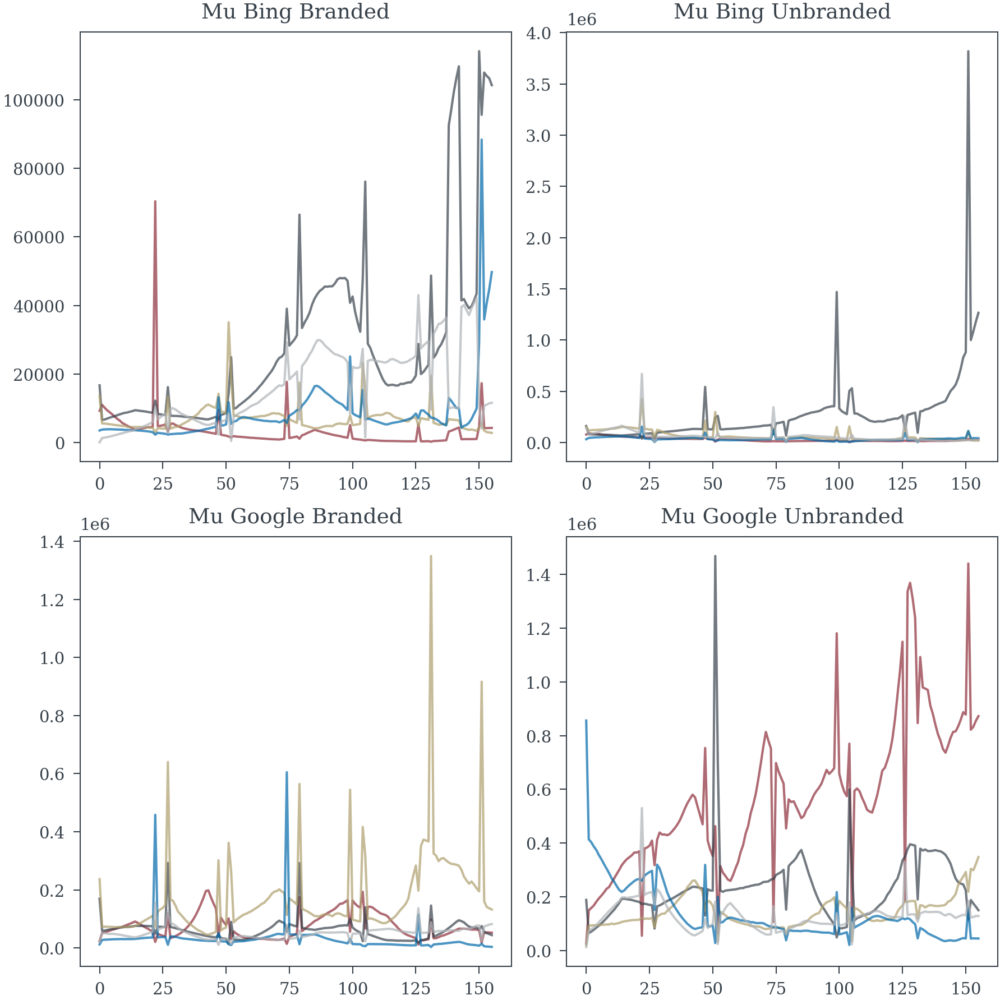

In [132]:
season_samples = pm.draw(season, 5)
trend_samples = pm.draw(trend, 5)
mu_samples = pm.draw(mu_why_bing, 5)
fig, ax = plt.subplots(2, 2, figsize=(6, 6))
for i in range(2):
    for j in range(2):
        ax[i, j].plot(season_samples[:, :, i, j].T, alpha=.7)
        ax[i, j].set_title(f"Seasonality {OUTLETS[i].capitalize()} {CAMPAIGNS[j].capitalize()}")
fig, ax = plt.subplots(2, 2, figsize=(6, 6))
for i in range(2):
    for j in range(2):
        ax[i, j].plot(trend_samples[:, :, i, j].T, alpha=.7)
        ax[i, j].set_title(f"trend {OUTLETS[i].capitalize()} {CAMPAIGNS[j].capitalize()}")    

fig, ax = plt.subplots(2, 2, figsize=(6, 6))
for i in range(2):
    for j in range(2):
        ax[i, j].plot(np.exp(mu_samples[:, :, i, j].T), alpha=.7)
        ax[i, j].set_title(f"Mu {OUTLETS[i].capitalize()} {CAMPAIGNS[j].capitalize()}")   

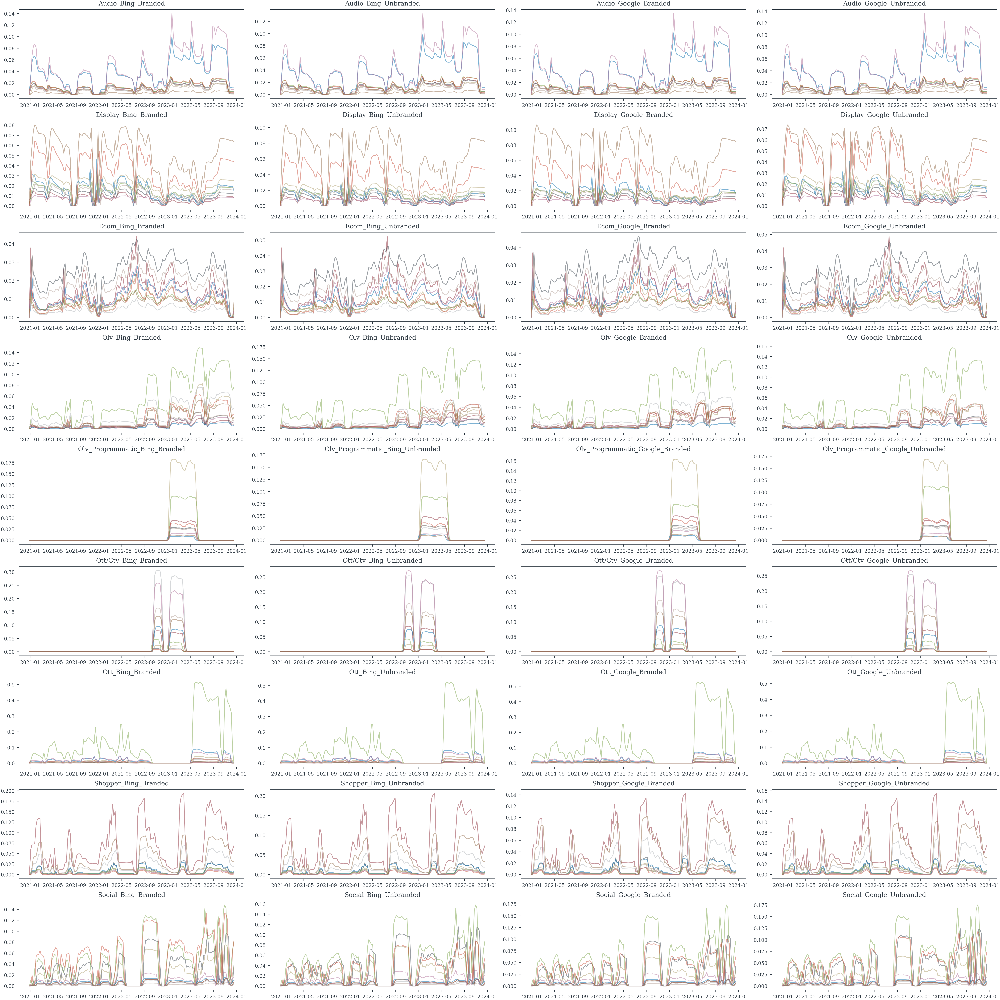

In [45]:
fig, ax = plt.subplots(len(MEDIA_VARS), 4, figsize=(20, 20))
media_effect_draws = pm.draw(media_effect, 10)
for i, media in enumerate(MEDIA_VARS):
    for j in range(4):
        ax[i, j].plot(dates, media_effect_draws[:, :, j//2, j%2, i].T, alpha=.5)
        ax[i, j].set_title(f"{media.replace('_IMPRESSIONS', '').lower().title()}_{['Bing', 'Google'][j//2]}_{['Branded', 'Unbranded'][j%2]}")